In [1]:
import geopandas as gpd
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import fiona as fio
import shapely as shp  
import esda
import geojson as gs
import seaborn as sns
import splot
from splot.esda import plot_moran
import contextily

In [19]:
# load in geojson files

gdf_ar = gpd.read_file('../data/gis/point/ar_samples_w_covars.geojson')

gdf_cnty = gpd.read_file('../data/gis/polygon/county.geojson')

gdf_geol = gpd.read_file('../data/gis/polygon/geology.geojson')

gdf_openmines = gpd.read_file('../data/gis/polygon/exposedmines.geojson')

gdf_mines = gpd.read_file('../data/gis/point/mines.geojson')

gdf_water = gpd.read_file('../data/gis/polygon/water.geojson')

gdf_faults = gpd.read_file('../data/gis/polygon/geofaults.geojson')

gdf_cropland = gpd.read_file('../data/gis/polygon/cropland.geojson')

gfd_pred = gpd.read_file('../data/gis/polygon/predicted-arsenic-clipped.geojson')


In [20]:

# function to print the name and crs for each geodataframe above

def print_crs():
    print('geology crs:', gdf_geol.crs)
    print('faults crs:', gdf_faults.crs)
    print('county crs:', gdf_cnty.crs)
    print('mines crs:', gdf_mines.crs)
    print('open mines crs:', gdf_openmines.crs)
    print('water crs:', gdf_water.crs)
    print('cropland crs:', gdf_cropland.crs)
    print('sample data crs:', gdf_ar.crs)
    print('predicted data crs:', gfd_pred.crs)

print_crs()

geology crs: EPSG:4269
faults crs: EPSG:32119
county crs: EPSG:4269
mines crs: EPSG:4269
open mines crs: EPSG:4269
water crs: EPSG:4269
cropland crs: EPSG:4269
sample data crs: EPSG:4269


In [21]:
gdf_faults.to_crs(epsg=4269, inplace=True)

In [24]:
# split gdf_ar into 2 for mapping, based on group value (>0.001)

nondetect = gdf_ar[gdf_ar['group'] == 0]

detect = gdf_ar[gdf_ar['group'] == 1]

In [25]:
# splits gdf_ar into 2 for mapping, based on group_five value (>0.005)

nondetect5 = gdf_ar[gdf_ar['group_five'] == 0]

detect5 = gdf_ar[gdf_ar['group_five'] == 1]

In [26]:
# splits gdf_ar into 2 for mapping, based on group_five value (>0.01)

nondetectmcl = gdf_ar[gdf_ar['group_mcl'] == 0]

detectmcl = gdf_ar[gdf_ar['group_mcl'] == 1]

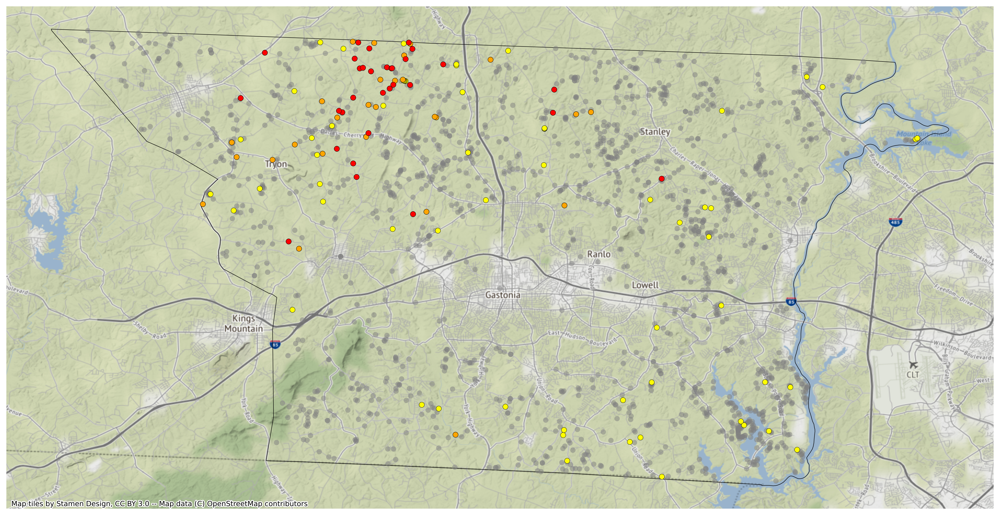

In [32]:
f, ax = plt.subplots(1, figsize=(20, 20), dpi=300)

gdf_cnty.plot(
    color="none",
    edgecolor="black",
    linewidth=0.5,
    ax=ax
)
nondetect.plot(
    color="grey",
    edgecolor="white",
    linewidth=0.0,
    alpha=0.5,
    ax=ax,
)
detect.plot(
    color="yellow",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
detect5.plot(
    color="orange",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
detectmcl.plot(
    color="red",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
contextily.add_basemap(
    ax,
    crs=detect.crs,
    source=contextily.providers.Stamen.Terrain,
)
ax.set_axis_off()

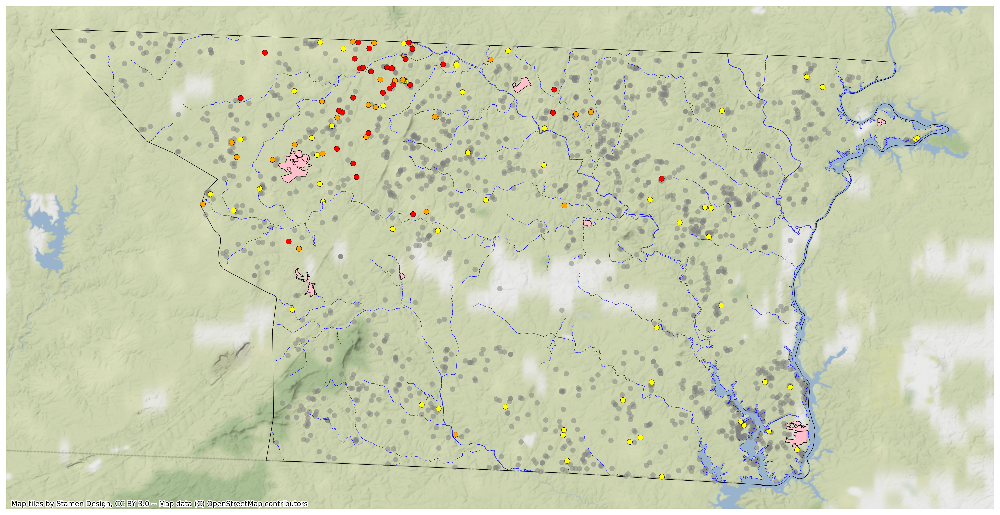

In [34]:
f, ax = plt.subplots(1, figsize=(20, 20), dpi=300)

gdf_cnty.plot(
    color="none",
    edgecolor="black",
    linewidth=0.5,
    ax=ax
)
gdf_water.plot(
    color="blue",
    edgecolor="blue",
    linewidth=0.3,
    ax=ax
)
gdf_openmines.plot(
    color="pink",
    edgecolor="black",
    linewidth=0.5,
    ax=ax
)
nondetect.plot(
    color="grey",
    edgecolor="white",
    linewidth=0.0,
    alpha=0.5,
    ax=ax,
)
detect.plot(
    color="yellow",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
detect5.plot(
    color="orange",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
detectmcl.plot(
    color="red",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
contextily.add_basemap(
    ax,
    crs=detect.crs,
    source=contextily.providers.Stamen.TerrainBackground,
)
ax.set_axis_off()

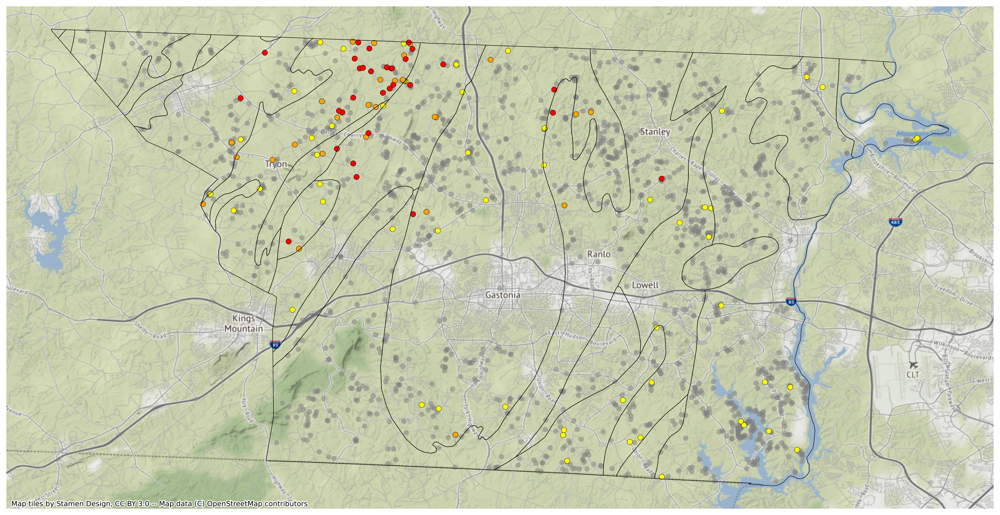

In [35]:
f, ax = plt.subplots(1, figsize=(20, 20), dpi=300)
nondetect.plot(
    color="grey",
    edgecolor="white",
    linewidth=0.0,
    alpha=0.5,
    ax=ax,
)
detect.plot(
    color="yellow",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
detect5.plot(
    color="orange",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)

detectmcl.plot(
    color="red",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
)
gdf_geol.plot(
    color="none",
    edgecolor="black",
    linewidth=0.5,
    ax=ax
)
gdf_faults.plot(
    color="brown",
    edgecolor="brown",
    linewidth=4,
    ax=ax
)
contextily.add_basemap(
    ax,
    crs=detect.crs,
    source=contextily.providers.Stamen.Terrain,
)

ax.set_axis_off()

In [ ]:

# read in polygon data

pred = gpd.read_file("../data/gis/polygon/predicted-arsenic-clipped.geojson")

fig, ax = plt.subplots(figsize=(20,10))
pred.plot(ax=ax, column='pred', cmap='OrRd', legend=True, alpha=0.2,
             legend_kwds={'loc': 'center left', 'bbox_to_anchor':(1,0.5)}, categories=['< 0.005','0.005 - 0.01','> 0.01'])
nondetect5.plot(
    color="grey",
    edgecolor="white",
    linewidth=0.0,
    alpha=0.5,
    ax=ax,
    Legend=True
)
detect5.plot(
    color="orange",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
    Legend=True
)
detectmcl.plot(
    color="red",
    edgecolor="black",
    linewidth=0.3,
    alpha=1,
    ax=ax,
    Legend=True
)
ctx.add_basemap(ax, crs=ar.crs.to_string(), source=ctx.providers.Stamen.Terrain)